# Dx score

```{contents}
```

## Load data

In [1]:
import pandas as pd
import sys
sys.path.append('../')
from source.pacmap_functions import *

mount = '/mnt/d/'
input_path = mount + 'MethylScore/Intermediate_Files/'
output_path = mount + 'MethylScore/Processed_Data/'

# read df_discovery and df_validation
df_discovery = pd.read_pickle(
    input_path+'3308samples_333059cpgs_withbatchcorrection_bvalues.pkl').sort_index()

df_validation = pd.read_pickle(
    input_path+'201samples_357839cpgs_withbatchcorrection_bvalues.pkl').sort_index()

# Load clinical data
discovery_clinical_data = pd.read_csv(input_path+'discovery_clinical_data.csv',
                                      low_memory=False, index_col=0)

# Load clinical data
validation_clinical_data = pd.read_csv(input_path+'validation_clinical_data.csv',
                                        low_memory=False, index_col=0)

# Adjust clinical data
discovery_clinical_data['Train-Test'] = 'Train Samples'

validation_clinical_data['Train-Test'] = 'Test Samples'

discovery_clinical_data['PaCMAP Output'] = 'Patient Samples'
validation_clinical_data['PaCMAP Output'] = 'Patient Samples'

discovery_clinical_data['Batch'] = df_discovery['Batch']
validation_clinical_data['Batch'] = 'St Jude Children\'s'


## Select CpGs in both train and test

In [2]:
# use overlapping features between df_discovery and df_validation
common_features = [x for x in df_discovery.columns if x in df_validation.columns]

# apply `common_features` to both df_discovery and df_validation
df_discovery = df_discovery[common_features]
df_validation = df_validation[common_features]

print(
f' Discovery dataset (df_discovery) contains {df_discovery.shape[1]} \
columns (5mC nucleotides/probes) and {df_discovery.shape[0]} rows (samples).')

print(
f' Validation dataset (df_validation) contains {df_validation.shape[1]} \
columns (5mC nucleotides/probes) and {df_validation.shape[0]} rows (samples).')

output_notebook()

# Set the theme for the plot
curdoc().theme = 'dark_minimal' # or 'dark_minimal'

 Discovery dataset (df_discovery) contains 319558 columns (5mC nucleotides/probes) and 3308 rows (samples).
 Validation dataset (df_validation) contains 319558 columns (5mC nucleotides/probes) and 201 rows (samples).


Loading BokehJS ...

## Assemble the acute leukemia methylome atlas

In [3]:
clinical_trials = [
                    'NOPHO ALL92-2000', 
                    'AAML0531',
                    'AAML1031',
                    'Beat AML Consortium',
                    'TCGA AML',
                    'CETLAM SMD-09 (MDS-tAML)',
                    'French GRAALL 2003–2005',
                    'TARGET ALL',
                    'AAML03P1',
                    'Japanese AML05',
                    'CCG2961'
                    ]

sample_types = ['Diagnosis', 'Primary Blood Derived Cancer - Bone Marrow', 'Bone Marrow Normal',
                'Primary Blood Derived Cancer - Peripheral Blood', 'Blood Derived Normal',
                'Relapse','Recurrent Blood Derived Cancer - Bone Marrow',
                'Recurrent Blood Derived Cancer - Peripheral Blood'
                ]

cols = ['Clinical Trial', 'Sample Type', 'Patient_ID', 'WHO 2022 Diagnosis',
        'ELN 2022 Diagnosis','Hematopoietic Entity' ,'Vital Status','Train-Test', 
        'Batch']

# components = [2,5]
# for n in components:
#     processor = DataProcessor(discovery_clinical_data.copy(),
#                               df_discovery,
#                               clinical_trials,
#                               sample_types,
#                               cols, 
#                               n_components=n,
#                               common_prefix=output_path+f'pacmap_output/pacmap_{n}d_model_peds_dx_al', 
#                               df_test=df_validation.copy(),
#                               test_clinical_data=validation_clinical_data.copy())
    
#     processor.filter_data()
#     processor.apply_pacmap() # learn PaCMAP on the training data
#     processor.apply_pacmap_test() # apply PaCMAP to the test data
#     processor.join_labels() # join clinical data to the embedding

#     # Save output
#     processor.df.to_csv(output_path+f'pacmap_output/pacmap_{n}d_model_dx_al.csv')

In [4]:
df = pd.read_csv(output_path+'pacmap_output/pacmap_2d_model_dx_al.csv', index_col=0)

# Concatenate discovery and validation clinical data
clinical_data = pd.concat([discovery_clinical_data, validation_clinical_data]).loc[df['index']]

# Select columns to plot
cols = ['WHO 2022 Diagnosis','ELN 2022 Diagnosis','Hematopoietic Entity','FAB', 'FLT3 ITD', 'Age (group years)',
        'Complex Karyotype' ,'Batch', 'Sex', 'MRD 1 Status', 'Leucocyte counts (10⁹/L)', 'Risk Group', 'Race or ethnic group', 'Trisomy 8 Status',
        'Clinical Trial', 'Vital Status','First Event','Sample Type', 'Train-Test']

# Join clinical data to the embedding
df = df.join(clinical_data[cols], rsuffix='_copy', on='index')

plotter = BokehPlotter(df, cols, get_custom_color_palette(),
                       title='',
                        x_range=(-45, 45), y_range=(-45, 45),
                        datapoint_size=4, tooltip_dx_cols='WHO 2022 Diagnosis',
                        width=1000, height=600)
plotter.plot()

## Patient characteristics table

In [5]:
from tableone import TableOne

columns = ['Hematopoietic Entity',
            'Clinical Trial',]

df_train = df[df['Train-Test']=='Train Samples']

mytable_cog = TableOne(df_train.reset_index(), columns,
                        overall=False, missing=False,
                        pval=False, pval_adjust=False,
                        htest_name=True,dip_test=True,
                        tukey_test=True, normal_test=True,

                        order={'FLT3 ITD':['Yes','No'],
                                'Age (group years)':['0-5','5-13','13-39','39-60'],
                                'MRD 1 Status': ['Positive'],
                                'Risk Group': ['High Risk', 'Standard Risk'],
                                'FLT3 ITD': ['Yes'],
                                'Leucocyte counts (10⁹/L)': ['≥30'],
                                'Age group (years)': ['≥10']})

# mytable_cog.to_excel('data/tableone_Dx_pacmap.xlsx')
# mytable_cog.to_csv(output_path + 'pacmap_output/tableone_Dx_pacmap.csv')

mytable_cog.tabulate(tablefmt="html", 
                        # headers=[score_name,"",'Missing','Discovery','Validation','p-value','Statistical Test']
                        )

,,Overall
n,,3047
"Hematopoietic Entity, n (%)",Acute lymphoblastic leukemia (ALL),700 (31.3)
,Acute myeloid leukemia (AML),1185 (53.0)
,Acute promyelocytic leukemia (APL),31 (1.4)
,Mixed phenotype acute leukemia (MPAL),50 (2.2)
,Myelodysplastic syndrome (MDS or MDS-like),142 (6.4)
,Otherwise-Normal (Control),128 (5.7)
"Clinical Trial, n (%)",AAML03P1,72 (2.4)
,AAML0531,628 (20.6)
,AAML1031,581 (19.1)


## Preprocess data for classifiers

### Load output from PaCMAP

Reloading it here to allow for running the cells below without running the PaCMAP code above.

In [6]:
import pandas as pd
import numpy as np

input_path = '/mnt/d/MethylScore/Intermediate_Files/'
output_path = '/mnt/d/MethylScore/Processed_Data/'

n_components = 5

# Create a list of strings containing "PaCMAP " + the number of components
components = [f'PaCMAP {i}' for i in range(1, n_components+1)]

# Load pacmap output data
df = pd.read_csv(output_path+f'pacmap_output/pacmap_{n_components}d_model_dx_al.csv', index_col=0)

### Select samples with vital status available

In [7]:
# drop the samples with missing labels for the ELN AML 2022 Diagnosis
df_px = df[~df['Vital Status'].isna()]

# print the number of samples dropped and the amount remaining
print(df.shape[0]-df_px.shape[0], 'samples removed.'\
, df_px.shape[0], 'samples remaining.')

1438 samples removed. 1810 samples remaining.


In [8]:
df_px['Clinical Trial'].value_counts()

Clinical Trial
AAML0531               628
AAML1031               581
Beat AML Consortium    225
AML02                  159
AAML03P1                72
TARGET ALL              47
AML08                   42
CCG2961                 41
Japanese AML05          15
Name: count, dtype: int64

In [9]:
df_px['WHO 2022 Diagnosis'].value_counts()

WHO 2022 Diagnosis
AML with t(v;11q23); KMT2A-r               350
AML with t(8;21); RUNX1::RUNX1T1           198
AML with inv(16); t(16;16); CBFB::MYH11    187
AML with mutated NPM1                      176
Otherwise-Normal Control                   111
AML with NUP98-fusion                       92
AML with mutated CEBPA                      71
MDS-related; secondary myeloid              66
AML with CBFA2T3::GLIS2                     30
AML with t(6;9); DEK::NUP214                27
MPAL T-Lymphoblastic/Myeloid                25
MPAL B-Lymphoblastic/Myeloid                19
AML with ETV6 fusion                        16
APL with t(15;17); PML::RARA                11
AML with t(8;16); KAT6A::CREBBP             10
AML with t(1;22); RBM15::MKL1                9
AML with inv(3); t(3;3); MECOM-r             9
AML with t(16;21); FUS::ERG                  4
MPAL with t(v;11q23.3)/KMT2A-r               3
Name: count, dtype: int64

### Select samples with WHO 2022 Diagnosis available

In [10]:
# drop the samples with missing labels for the ELN AML 2022 Diagnosis
df_dx = df[~df['WHO 2022 Diagnosis'].isna()]

# drop samples from `df['Hematopoietic Entity']` that contain `ALL` and `MPAL` and `Otherwise-Normal Control` and `APL`
# df = df[df['Hematopoietic Entity'].isin(['Acute myeloid leukemia (AML)'])]

# print the number of samples dropped and the amount remaining
print(df.shape[0]-df_dx.shape[0], 'samples removed.'\
, df_dx.shape[0], 'samples remaining.')

910 samples removed. 2338 samples remaining.


### Select Dx subtypes with at least 10 samples

In [11]:
# exclude the samples with mixed phenotypes and Down syndrome and t(9;22)(q34.1;q11.2)/BCR::ABL1
df_dx2 = df_dx[~df_dx['WHO 2022 Diagnosis'].isin([
                                    'AML with t(1;22); RBM15::MKL1',
                                       'MPAL with t(v;11q23.3)/KMT2A-r',
                                       'B-ALL with hypodiploidy',
                                       'AML with t(16;21); FUS::ERG',
                                       'AML with t(9;22); BCR::ABL1'
                                       ])]

# print the number of samples dropped and the amount remaining
print(df_dx.shape[0]-df_dx2.shape[0], 'samples removed.'\
, df_dx2.shape[0], 'samples remaining, which includes 111 test samples')

df_dx['WHO 2022 Diagnosis'].value_counts(dropna=False)
                                       

27 samples removed. 2311 samples remaining, which includes 111 test samples


WHO 2022 Diagnosis
AML with t(v;11q23); KMT2A-r               364
T-ALL NOS                                  242
AML with mutated NPM1                      226
AML with t(8;21); RUNX1::RUNX1T1           205
AML with inv(16); t(16;16); CBFB::MYH11    201
B-ALL with hyperdiploidy                   190
B-ALL with t(12;21); ETV6::RUNX1           163
MDS-related; secondary myeloid             142
Otherwise-Normal Control                   128
AML with NUP98-fusion                       95
AML with mutated CEBPA                      85
APL with t(15;17); PML::RARA                31
AML with CBFA2T3::GLIS2                     30
B-ALL with t(v;11q23); KMT2A-r              28
AML with t(6;9); DEK::NUP214                27
MPAL T-Lymphoblastic/Myeloid                25
B-ALL with t(1;19); TCF3::PBX1              23
B-ALL dic(9;20)                             20
MPAL B-Lymphoblastic/Myeloid                19
B-ALL with t(9;22); BCR::ABL1               19
AML with ETV6 fusion                     

### Define X and y

In [12]:
def custom_train_test_split(df, feature_columns, target_column, split_column):

    X = df[feature_columns].to_numpy()
    y = df[target_column].to_numpy()

    train_mask = df[split_column] == 'Train Samples'
    test_mask = df[split_column] == 'Test Samples'

    X_train, X_test = X[train_mask], X[test_mask]
    y_train, y_test = y[train_mask], y[test_mask]

    return X_train, X_test, y_train, y_test

# Execution
X_train, X_test, y_train, y_test = custom_train_test_split(df_dx2, components,'WHO 2022 Diagnosis', 'Train-Test')

# print the number of samples in each set
print('X_train shape:', X_train.shape, 'X_test shape:', X_test.shape)


X_train shape: (2209, 5) X_test shape: (102, 5)


## Benchmark multi-class (diagnostic) classifier

### Define confusion matrix plot function

In [36]:
import sys
sys.path.append('../')

# from source.data_visualization_functions import plot_confusion_matrix_stacked

def plot_confusion_matrix_stacked(clf, x_train, y_train, x_test, y_test, 
                                  title='', 
                                  tick_fontsize=10, label_fontsize=10,
                                  figsize=(10, 5)):

    from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
    import seaborn as sns
    import matplotlib.pyplot as plt

    sns.set_theme(style='white')

    fig, axs = plt.subplots(1, 2, figsize=figsize, sharey=True)

    # Adjust subplot parameters to reduce the space between them
    fig.subplots_adjust(wspace=0.05)  # Adjust the width space

    # Add a supertitle to the figure
    # fig.suptitle(title + ' on clinically annotated samples', fontsize=12, fontweight='bold')

    for i, (ax, x, y, subset) in enumerate(zip(axs, [x_train, x_test], [y_train, y_test],
                                                ['Train with 10-fold CV', 'Validation'])):
        predictions = clf.predict(x)
        cm = confusion_matrix(y, predictions, labels=clf.classes_, normalize='true')
        disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=clf.classes_)
        disp.plot(cmap='Blues', values_format='.2f', xticks_rotation='vertical', colorbar=False, ax=ax)

        # Decrease the font size of the numbers inside the confusion matrix
        for texts in disp.text_:
            for text in texts:
                text.set_fontsize(label_fontsize)

        # Decrease the font size of the tick labels
        ax.tick_params(axis='both', which='major', labelsize=tick_fontsize)

        # Add title for each panel
        ax.set_title(subset + ', n=' + str(len(x)), fontsize=label_fontsize+1, pad=10)

        # Add x labels
        ax.set_xlabel('Predicted label', fontsize=label_fontsize+1)

        # Add y labels
        if i == 0:
            ax.set_ylabel('True label', fontsize=label_fontsize+1)

        # remove x tick labels
        ax.xaxis.set_ticklabels([])
        
        # remove y label for the second plot
        if i == 1:
            ax.set_ylabel('')

    plt.show()

### LightGBM

Best parameters: {'learning_rate': 0.02, 'n_estimators': 200, 'num_leaves': 6}
Best cross-validation score (not final): 0.973
Overall accuracy score with best estimator in train: 0.899
Overall accuracy score with best estimator in test: 0.951


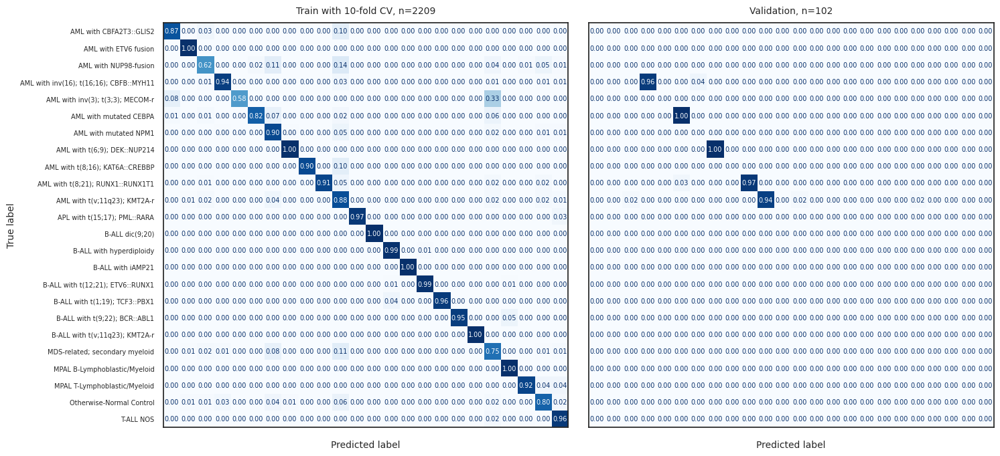

In [26]:
from sklearn.model_selection import GridSearchCV, StratifiedKFold
from lightgbm import LGBMClassifier
from sklearn.metrics import accuracy_score


param_grid = {
    'num_leaves': [4, 5, 6, 7, 8], # number of leaves in full tree, which will roughly be the same as max number of features in one-hot encoding
    'learning_rate': [0.001, 0.01, 0.015, 0.02, 0.1],  # learning rate
    'n_estimators': [100, 150, 200, 250, 300,],  # number of trees (or rounds)
}

# Initialize the LGBM Classifier
lgbm = LGBMClassifier(random_state=42, n_jobs=-1)

# Initialize StratifiedKFold
# stratified_kfold = StratifiedKFold(n_splits=10, shuffle=True, random_state=42)

# Perform grid search with stratified cross-validation
grid_search = GridSearchCV(lgbm, param_grid, cv=10, n_jobs=-1, scoring='roc_auc_ovr_weighted', verbose=0)
grid_search.fit(X_train, y_train)

# Print the best parameters and the best score
print(f"Best parameters: {grid_search.best_params_}")
print(f"Best cross-validation score (not final): {grid_search.best_score_:.3f}")

# Fit and predict using the best estimator
lgbm_dx_model = grid_search.best_estimator_

y_pred_train = lgbm_dx_model.predict(X_train)  # Predict using the best model
y_pred_test = lgbm_dx_model.predict(X_test)  # Predict using the best model

print(f'Overall accuracy score with best estimator in train: {accuracy_score(y_train, y_pred_train):.3f}')
print(f'Overall accuracy score with best estimator in test: {accuracy_score(y_test, y_pred_test):.3f}')

# you shall save the model
import pickle
pickle.dump(lgbm_dx_model, open('../models/lgbm_dx_model.pkl', 'wb'))

# plot the confusion matrix
plot_confusion_matrix_stacked(lgbm_dx_model, X_train, y_train, X_test, y_test,
                              tick_fontsize=7, label_fontsize=7, figsize = (16,8))

### Gaussian Process

Best parameters: {'multi_class': 'one_vs_rest'}
Best cross-validation score: 0.968
Overall accuracy score with best estimator in train: 0.870
Overall accuracy score with best estimator in test: 0.931


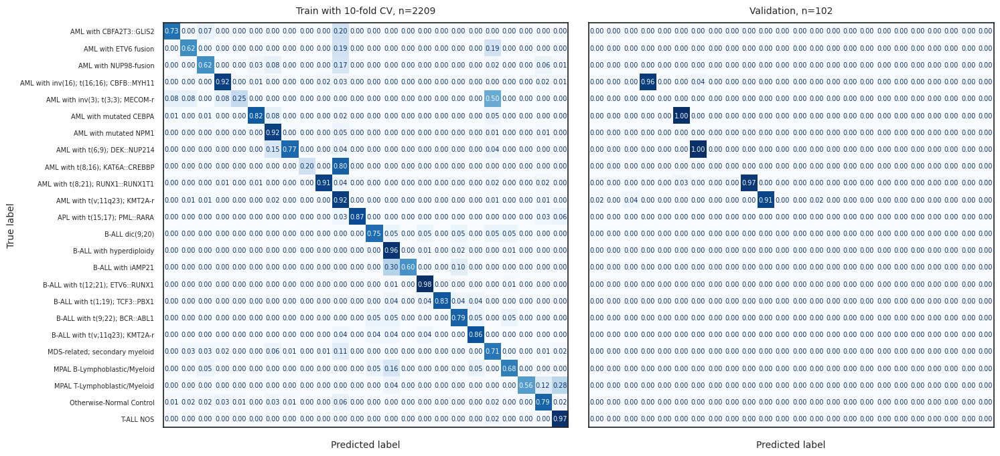

In [27]:
from sklearn.gaussian_process import GaussianProcessClassifier

# Define the parameter grid
param_grid = {
    'multi_class': ['one_vs_rest'],  # one_vs_rest is the only option for multi-class classification
}

# Initialize the Gaussian Process Classifier
gpc = GaussianProcessClassifier(random_state=42, n_jobs=-1)

# Perform grid search with cross-validation
grid_search = GridSearchCV(gpc, param_grid, cv=10, n_jobs=-1, scoring='roc_auc_ovr_weighted')
grid_search.fit(X_train, y_train)

# Fit and predict using the best estimator
gpc_dx_model = grid_search.best_estimator_

y_pred = gpc_dx_model.predict(X_test)  # Predict using the best model

# Print the best parameters and the best score
print(f"Best parameters: {grid_search.best_params_}")
print(f"Best cross-validation score: {grid_search.best_score_:.3f}")

# Fit and predict using the best estimator
gpc_dx_model = grid_search.best_estimator_

y_pred_train = gpc_dx_model.predict(X_train)  # Predict using the best model
y_pred_test = gpc_dx_model.predict(X_test)  # Predict using the best model


print(f'Overall accuracy score with best estimator in train: {accuracy_score(y_train, y_pred_train):.3f}')
print(f'Overall accuracy score with best estimator in test: {accuracy_score(y_test, y_pred_test):.3f}')

# plot the confusion matrix
plot_confusion_matrix_stacked(gpc_dx_model, X_train, y_train, X_test, y_test,
                              tick_fontsize=7, label_fontsize=7, figsize = (16,8))

# you shall save the model
pickle.dump(gpc_dx_model, open('../models/gpc_dx_model.pkl', 'wb'))


## Benchmark binary (prognostic) classifier

### Redefine X and y

In [29]:
# Execution:
X_train, X_test, y_train, y_test = custom_train_test_split(df_px, components,'Vital Status', 'Train-Test')

# print the number of samples in each set
print('X_train shape:', X_train.shape, 'X_test shape:', X_test.shape)

X_train shape: (1609, 5) X_test shape: (201, 5)


### LightGBM

Best parameters: {'learning_rate': 0.1, 'n_estimators': 300, 'num_leaves': 4}
Overall accuracy score with best estimator in train: 0.755
Overall accuracy score with best estimator in test: 0.687


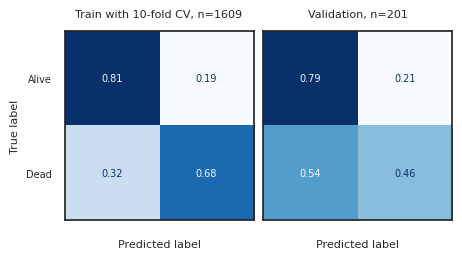

In [42]:
from sklearn.model_selection import GridSearchCV, StratifiedKFold
from lightgbm import LGBMClassifier
from sklearn.metrics import accuracy_score


param_grid = {
    'num_leaves': [2, 3, 4, 5, 6, 7, 8], # number of leaves in full tree, which will roughly be the same as max number of features in one-hot encoding
    'learning_rate': [0.001, 0.01, 0.015, 0.02, 0.1],  # learning rate
    'n_estimators': [100, 150, 200, 250, 300],  # number of trees (or rounds)
}

# Initialize the LGBM Classifier
lgbm = LGBMClassifier(random_state=42, n_jobs=-1)

# Initialize StratifiedKFold
# stratified_kfold = StratifiedKFold(n_splits=10, shuffle=True, random_state=42)

# Perform grid search with stratified cross-validation
grid_search = GridSearchCV(lgbm, param_grid, cv=10, n_jobs=-1, scoring='roc_auc_ovr_weighted', verbose=0)
grid_search.fit(X_train, y_train)

# Print the best parameters and the best score
print(f"Best parameters: {grid_search.best_params_}")

# Fit and predict using the best estimator
lgbm_px_model = grid_search.best_estimator_

y_pred_train = lgbm_px_model.predict(X_train)  # Predict using the best model
y_pred_test = lgbm_px_model.predict(X_test)  # Predict using the best model

print(f'Overall accuracy score with best estimator in train: {accuracy_score(y_train, y_pred_train):.3f}')
print(f'Overall accuracy score with best estimator in test: {accuracy_score(y_test, y_pred_test):.3f}')

# you shall save the model
import pickle
pickle.dump(lgbm_px_model, open('../models/lgbm_px_model.pkl', 'wb'))

# plot the confusion matrix
plot_confusion_matrix_stacked(lgbm_px_model, X_train, y_train, X_test, y_test,
                              tick_fontsize=7, label_fontsize=7, figsize = (5,3))

### Gaussian Process Classifier

Best parameters: {'multi_class': 'one_vs_rest'}
Overall accuracy score with best estimator in train: 0.765
Overall accuracy score with best estimator in test: 0.706


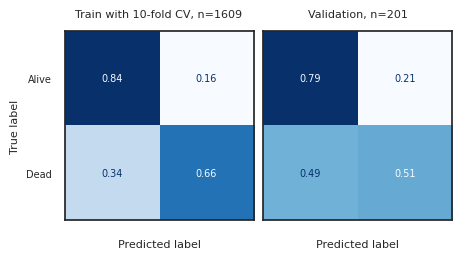

In [45]:
from sklearn.gaussian_process import GaussianProcessClassifier

# Define the parameter grid
param_grid = {
    'multi_class': ['one_vs_rest'], 
}

# Initialize the Gaussian Process Classifier
gpc = GaussianProcessClassifier(random_state=42, n_jobs=-1)

# Perform grid search with cross-validation
grid_search = GridSearchCV(gpc, param_grid, cv=10, n_jobs=-1, scoring='roc_auc_ovr_weighted')
grid_search.fit(X_train, y_train)

# Fit and predict using the best estimator
gpc_px_model = grid_search.best_estimator_

y_pred = gpc_px_model.predict(X_test)  # Predict using the best model

# Print the best parameters and the best score
print(f"Best parameters: {grid_search.best_params_}")

# Fit and predict using the best estimator
gpc_px_model = grid_search.best_estimator_

y_pred_train = gpc_px_model.predict(X_train)  # Predict using the best model
y_pred_test = gpc_px_model.predict(X_test)  # Predict using the best model


print(f'Overall accuracy score with best estimator in train: {accuracy_score(y_train, y_pred_train):.3f}')
print(f'Overall accuracy score with best estimator in test: {accuracy_score(y_test, y_pred_test):.3f}')

# plot the confusion matrix
plot_confusion_matrix_stacked(gpc_px_model, X_train, y_train, X_test, y_test,
                              tick_fontsize=7, label_fontsize=7, figsize = (5,3))

# you shall save the model
pickle.dump(gpc_px_model, open('../models/gpc_px_model.pkl', 'wb'))


## Save results

In [71]:
def save_predictions(df, classifier, model_name):
    # Select necessary columns and set the index
    df_features = df.set_index('index')[['PaCMAP 1', 'PaCMAP 2', 'PaCMAP 3', 'PaCMAP 4', 'PaCMAP 5']]

    # Predict using the selected columns
    predictions = classifier.predict(df_features)

    # Predict probabilities using the selected columns
    probabilities = classifier.predict_proba(df_features)

    # Convert predictions to a Series with the same index as df_features
    predictions_series = pd.Series(predictions, index=df_features.index, name=model_name)

    # Convert probabilities to a DataFrame with the same index as df_features and the same columns as the classes
    probabilities_df = pd.DataFrame(probabilities, index=df_features.index, columns=classifier.classes_).round(3)

    # Add " - predict_proba" to the column names
    probabilities_df.columns ='P(' + probabilities_df.columns + ')'

    # # Create a new column named "Confidence" and set it to True if the max probability is >= confidence_threshold
    # probabilities_df['Confidence >=' + str(confidence_threshold)] = probabilities_df.max(axis=1) >= confidence_threshold

    # Transform classes of the predictions into integers based on unique values in the classes
    probabilities_df[model_name + ' class number'] = predictions_series.map({c: i for i, c in enumerate(classifier.classes_)})

    # Join predictions with the original DataFrame (already indexed)
    df_joined = df.set_index('index').join(predictions_series).join(probabilities_df)

    return df_joined

# Execution
df_pred_px = save_predictions(df=df,classifier=gpc_px_model, model_name='AML Epigenomic Risk Model')
df_pred_dx = save_predictions(df=df_pred_px, classifier=gpc_dx_model, model_name='AL Epigenomic Subtype Model')

# Write the final DataFrame to a CSV file
# df_pred_px.to_excel('../data/pacmap_5d_output_acute_leukemia_with_predictions.xlsx')

In [72]:
df_pred_px

,PaCMAP 1,PaCMAP 2,PaCMAP 3,PaCMAP 4,PaCMAP 5,Clinical Trial,Sample Type,Patient_ID,WHO 2022 Diagnosis,ELN 2022 Diagnosis,Hematopoietic Entity,Vital Status,Train-Test,Batch,MethylScoreAML-Px,P(Alive),P(Dead),MethylScoreAML-Px class number
index,,,,,,,,,,,,,,,,,,
0003fe29-7b8f-4ef1-b9bc-40306205f1fd_noid,13.626789,-10.502514,13.773472,15.153111,-20.012420,AAML03P1,Primary Blood Derived Cancer - Bone Marrow,PANVPB,NaN,NaN,NaN,Dead,Train Samples,GDC_TARGET-AML,Alive,0.544,0.456,0
0031efba-f564-4fff-bd7b-2b97f37218c1_noid,-5.748885,-1.390628,9.531257,11.911838,10.851721,AAML0531,Bone Marrow Normal,PASDKZ,Otherwise-Normal Control,Otherwise-Normal Control,Otherwise-Normal (Control),Dead,Train Samples,GDC_TARGET-AML,Dead,0.331,0.669,1
0037ec75-bb9e-4dbb-a2d9-de1f9bfd2362_noid,13.287992,-14.148166,-2.753327,-14.545814,-12.037717,AAML0531,Primary Blood Derived Cancer - Peripheral Blood,PASDKZ,AML with NUP98-fusion,AML with other recurring translocations,Acute myeloid leukemia (AML),Dead,Train Samples,GDC_TARGET-AML,Dead,0.294,0.706,1
003d9efe-90a1-42cf-84c4-03fbabefe60b_noid,-13.049528,3.397200,-17.993467,-2.611906,-20.007190,TARGET ALL,Bone Marrow Normal,TARGET-00-SJNORM054698,Otherwise-Normal Control,Otherwise-Normal Control,Otherwise-Normal (Control),NaN,Train Samples,GDC_TARGET-ALL,Dead,0.479,0.521,1
004c953f-d999-4d82-898d-c091e692df3c_noid,-13.222766,-16.385720,-0.017221,22.111477,-16.511988,AAML0531,Primary Blood Derived Cancer - Peripheral Blood,PASAUT,NaN,NaN,NaN,Alive,Train Samples,GDC_TARGET-AML,Alive,0.601,0.399,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9426021149_R04C01,-12.013118,11.932325,19.536495,-2.721256,-19.217108,AML08,Diagnosis,AML08_SP_120,AML with t(v;11q23); KMT2A-r,AML with t(v;11q23); KMT2A-r,Acute myeloid leukemia (AML),Alive,Test Samples,St Jude Children's,Dead,0.299,0.701,1
9426021149_R04C02,1.331688,21.806025,-12.777479,-9.378834,13.994673,AML08,Diagnosis,AML08_SP_48,AML with t(8;21); RUNX1::RUNX1T1,AML with t(8;21); RUNX1::RUNX1T1,Acute myeloid leukemia (AML),Dead,Test Samples,St Jude Children's,Alive,0.717,0.283,0
9426021149_R05C01,1.401615,21.364834,-12.854857,-9.732266,13.884876,AML08,Diagnosis,AML08_SP_240,AML with t(8;21); RUNX1::RUNX1T1,AML with t(8;21); RUNX1::RUNX1T1,Acute myeloid leukemia (AML),Dead,Test Samples,St Jude Children's,Alive,0.690,0.310,0


In [55]:
import numpy as np
#  Select necessary columns and set the index
df_selected = df.set_index('index')[['PaCMAP 1', 'PaCMAP 2', 'PaCMAP 3', 'PaCMAP 4', 'PaCMAP 5']]

# Predict using the selected columns
predictions = gpc_px_model.predict(df_selected)

# Predict probabilities using the selected columns
probabilities = gpc_px_model.predict_proba(df_selected)

# Convert predictions to a Series with the same index as df_selected
predictions_series = pd.Series(predictions, index=df_selected.index, name='MethylScoreAML_Dx_predictions')

# Convert probabilities to a DataFrame with the same index as df_selected and the same columns as the classes
probabilities_df = pd.DataFrame(probabilities, index=df_selected.index, columns=gpc_px_model.classes_).round(3)

# Add " - predict_proba" to the column names
probabilities_df.columns = probabilities_df.columns + ' - predict_proba'

# # Create a new column named "Confident" and set it to True if the max probability is >= 0.8
confidence_threshold = 0.6
probabilities_df['Confidence >=' + str(confidence_threshold)] = probabilities_df.max(axis=1) >= confidence_threshold

# Join predictions with the original DataFrame (already indexed)
df_joined = df.set_index('index').join(predictions_series).join(probabilities_df)

# Write the final DataFrame to a CSV file
df_joined.to_excel('../data/pacmap_5d_output_acute_leukemia_with_predictions.xlsx')

In [56]:
df_joined

,PaCMAP 1,PaCMAP 2,PaCMAP 3,PaCMAP 4,PaCMAP 5,Clinical Trial,Sample Type,Patient_ID,WHO 2022 Diagnosis,ELN 2022 Diagnosis,Hematopoietic Entity,Vital Status,Train-Test,Batch,MethylScoreAML_Dx_predictions,Alive - predict_proba,Dead - predict_proba,Confidence >=0.6
index,,,,,,,,,,,,,,,,,,
0003fe29-7b8f-4ef1-b9bc-40306205f1fd_noid,13.626789,-10.502514,13.773472,15.153111,-20.012420,AAML03P1,Primary Blood Derived Cancer - Bone Marrow,PANVPB,NaN,NaN,NaN,Dead,Train Samples,GDC_TARGET-AML,Alive,0.544,0.456,False
0031efba-f564-4fff-bd7b-2b97f37218c1_noid,-5.748885,-1.390628,9.531257,11.911838,10.851721,AAML0531,Bone Marrow Normal,PASDKZ,Otherwise-Normal Control,Otherwise-Normal Control,Otherwise-Normal (Control),Dead,Train Samples,GDC_TARGET-AML,Dead,0.331,0.669,True
0037ec75-bb9e-4dbb-a2d9-de1f9bfd2362_noid,13.287992,-14.148166,-2.753327,-14.545814,-12.037717,AAML0531,Primary Blood Derived Cancer - Peripheral Blood,PASDKZ,AML with NUP98-fusion,AML with other recurring translocations,Acute myeloid leukemia (AML),Dead,Train Samples,GDC_TARGET-AML,Dead,0.294,0.706,True
003d9efe-90a1-42cf-84c4-03fbabefe60b_noid,-13.049528,3.397200,-17.993467,-2.611906,-20.007190,TARGET ALL,Bone Marrow Normal,TARGET-00-SJNORM054698,Otherwise-Normal Control,Otherwise-Normal Control,Otherwise-Normal (Control),NaN,Train Samples,GDC_TARGET-ALL,Dead,0.479,0.521,False
004c953f-d999-4d82-898d-c091e692df3c_noid,-13.222766,-16.385720,-0.017221,22.111477,-16.511988,AAML0531,Primary Blood Derived Cancer - Peripheral Blood,PASAUT,NaN,NaN,NaN,Alive,Train Samples,GDC_TARGET-AML,Alive,0.601,0.399,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9426021149_R04C01,-12.013118,11.932325,19.536495,-2.721256,-19.217108,AML08,Diagnosis,AML08_SP_120,AML with t(v;11q23); KMT2A-r,AML with t(v;11q23); KMT2A-r,Acute myeloid leukemia (AML),Alive,Test Samples,St Jude Children's,Dead,0.299,0.701,True
9426021149_R04C02,1.331688,21.806025,-12.777479,-9.378834,13.994673,AML08,Diagnosis,AML08_SP_48,AML with t(8;21); RUNX1::RUNX1T1,AML with t(8;21); RUNX1::RUNX1T1,Acute myeloid leukemia (AML),Dead,Test Samples,St Jude Children's,Alive,0.717,0.283,True
9426021149_R05C01,1.401615,21.364834,-12.854857,-9.732266,13.884876,AML08,Diagnosis,AML08_SP_240,AML with t(8;21); RUNX1::RUNX1T1,AML with t(8;21); RUNX1::RUNX1T1,Acute myeloid leukemia (AML),Dead,Test Samples,St Jude Children's,Alive,0.690,0.310,True


## Watermark

In [ ]:
%load_ext watermark

The watermark extension is already loaded. To reload it, use:
  %reload_ext watermark


In [ ]:
# watermark with all libraries used in this notebook
%watermark -v -p numpy,pandas,bokeh,pacmap,itables -a Francisco_Marchi@Lamba_Lab_UF -d -m

Author: Francisco_Marchi@Lamba_Lab_UF

Python implementation: CPython
Python version       : 3.8.16
IPython version      : 8.12.2

numpy  : 1.24.3
pandas : 2.0.2
bokeh  : 3.1.1
pacmap : 0.7.0
itables: 1.5.2

Compiler    : GCC 11.3.0
OS          : Linux
Release     : 5.15.133.1-microsoft-standard-WSL2
Machine     : x86_64
Processor   : x86_64
CPU cores   : 20
Architecture: 64bit

